# STFTs and blues

In [2]:
%matplotlib inline 
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd 
import librosa, librosa.display
from glob import glob

## Loading an audio file

In [3]:
audio_files = glob('*.mp3')
x , sr = librosa.load(audio_files[0])
print("The sample rate is : " + str(sr) + ' Hz')
ipd.Audio(x , rate =sr )

The sample rate is : 22050 Hz


## Finding the STFT

* n_fft = window size  
* hop_length = number of audio frames between STFT columns
 * defaults to win_length / 4. What does the number of audio frames between STFT columns mean ? 
* this function can also specify the window type eg. Hanning etc

See below for all input parameters : 
https://librosa.github.io/librosa/generated/librosa.core.stft.html?highlight=stft#librosa.core.stft

In [4]:
hop_length = 512
n_fft = 2048
X = librosa.stft(x , n_fft=n_fft, hop_length=hop_length)
X.shape

(1025, 14799)

## Mel-spectrogram

A mel spectrogram plots the y-axis on the mel scale.

In [5]:
hop_length = 256 
S  = librosa.feature.melspectrogram(x , sr = sr, n_fft=4096, hop_length=hop_length)
logS = librosa.power_to_db(abs(S))

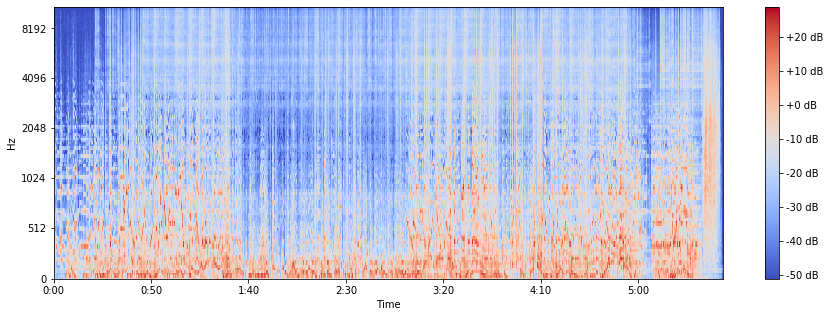

In [6]:
plt.figure(figsize=(15, 5))
librosa.display.specshow(logS, sr=sr, hop_length=hop_length, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')

## Chromagram

Separate groups of harmonics into chroma

Text(0.5, 1.0, 'CQT Chromagram')

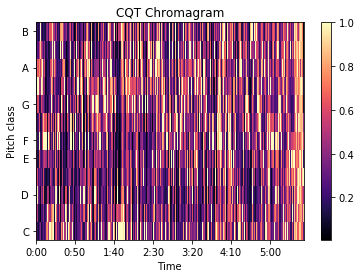

In [7]:
C  = librosa.feature.chroma_cqt(x , sr = sr)
librosa.display.specshow(C,y_axis='chroma', x_axis= 'time')
plt.colorbar()
plt.title('CQT Chromagram')

It can be observed that the most prominent pitches are within the F extended blues scale : 
* blues scale: F - G - Ab - A - Bb - B - C - D - Eb 

# 12 bar blues 

We can take out just a segment of the recording corresponding to just 12 bars. The trio is in full swing by 45 seconds after Bill's introduction. 
* 12 bars - [45 seconds, 68 seconds]
* added about 3 seconds padding either side

In [8]:
# Convert interval into frame numbers 
start = 40 
end = 70
sample_progression = librosa.time_to_samples(numpy.arange(start,end,1), sr = sr)
#  grab the starting and ending frames
start_sample = sample_progression[0]
end_sample = sample_progression[-1]

In [9]:
# Checking the audio
ipd.Audio(x[start_sample:end_sample], rate=sr)

## Time Frequency Analysis 

### Mel Spectrogram

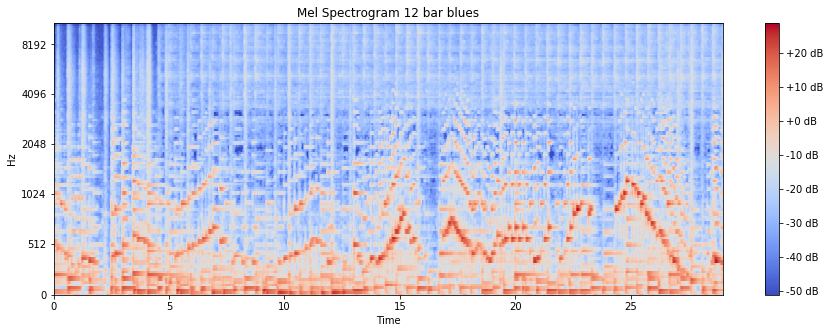

In [10]:
twelve_bars = x [start_sample:end_sample]

hop_length = 256 
S  = librosa.feature.melspectrogram(twelve_bars , sr = sr, n_fft=4096, hop_length=hop_length)
logS = librosa.power_to_db(abs(S))

plt.figure(figsize=(15, 5))
librosa.display.specshow(logS, sr=sr, hop_length=hop_length, x_axis='time', y_axis='mel')
plt.title('Mel Spectrogram 12 bar blues')
plt.colorbar(format='%+2.0f dB')

### Chromagram

Text(0.5, 1.0, 'CQT Chromagram 12 bar blues')

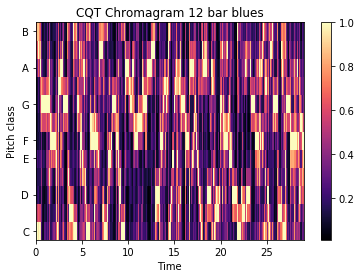

In [11]:
twelve_bars = x [start_sample:end_sample]

# Chromagram 
C  = librosa.feature.chroma_cqt(twelve_bars , sr = sr)
librosa.display.specshow(C,y_axis='chroma', x_axis= 'time')
plt.colorbar()
plt.title('CQT Chromagram 12 bar blues')